## Theoretical aspects

The core mechanism of **molecular dynamics (MD)** is **numerically solving Newton’s equation of motion** by deriving the **potential energy** (i.e. the energy of bonded and non-bonded interactions) for each atom during propagation of their changes in position upon time. These changes in position are the consequence of both **atom-atom interactions** and **thermal motions** (kinetic energy).

Inspired by the COVID-19 pandemic, perfom an MD simulation of the **papain-like protease of SARS-CoV-2**, a current drug-design target to combat this virus.

For our laboratory session, we will compile and install **GROMACS**, an MD simulation package that we will use to set-up and perform our simulations. We will visualize our protein structure using **py3Dmol**, while the simulation trajectories from our MD production runs will be visualized in a web version of **NGLview**.

# Downloading and Installing the required software

Then, we must install three pieces of software to perform this tutorial. Namely:
- **biopython** for manipulation of the PDB files
- **py3Dmol** for visualization of the protein structure.
- **GROMACS** for preparing our MD system and performing our MD simulations.

In [ ]:
# Download and unzip the compressed folder of GROMACS 2020.6 version
!wget https://raw.githubusercontent.com/pb3lab/ibm3202/master/software/gromacs.tar.gz
!tar xzf gromacs.tar.gz

--2022-10-06 19:00:39--  https://raw.githubusercontent.com/pb3lab/ibm3202/master/software/gromacs.tar.gz
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 35608971 (34M) [application/octet-stream]
Saving to: ‘gromacs.tar.gz’

gromacs.tar.gz      100%[===================>]  33.96M  --.-KB/s    in 0.1s    

2022-10-06 19:00:42 (229 MB/s) - ‘gromacs.tar.gz’ saved [35608971/35608971]



In [ ]:
# It is recommended (and required for GROMACS 2021) to upgrade cmake
!pip install cmake --upgrade

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 23.3 MB 1.4 MB/s 
  Attempting uninstall: cmake
    Found existing installation: cmake 3.22.6
    Uninstalling cmake-3.22.6:
      Successfully uninstalled cmake-3.22.6


In [ ]:
# Checking that our GROMACS works
%%bash
source /content/gromacs/bin/GMXRC
gmx -h

SYNOPSIS

gmx [-[no]h] [-[no]quiet] [-[no]version] [-[no]copyright] [-nice <int>]
    [-[no]backup]

OPTIONS

Other options:

 -[no]h                     (no)
           Print help and quit
 -[no]quiet                 (no)
           Do not print common startup info or quotes
 -[no]version               (no)
           Print extended version information and quit
 -[no]copyright             (yes)
           Print copyright information on startup
 -nice   <int>              (19)
           Set the nicelevel (default depends on command)
 -[no]backup                (yes)
           Write backups if output files exist

Additional help is available on the following topics:
    commands    List of available commands
    selections  Selection syntax and usage
To access the help, use 'gmx help <topic>'.
For help on a command, use 'gmx help <command>'.


                         :-) GROMACS - gmx, 2020.6 (-:

                            GROMACS is written by:
     Emile Apol      Rossen Apostolov      Paul Bauer     Herman J.C. Berendsen
    Par Bjelkmar      Christian Blau   Viacheslav Bolnykh     Kevin Boyd    
 Aldert van Buuren   Rudi van Drunen     Anton Feenstra       Alan Gray     
  Gerrit Groenhof     Anca Hamuraru    Vincent Hindriksen  M. Eric Irrgang  
  Aleksei Iupinov   Christoph Junghans     Joe Jordan     Dimitrios Karkoulis
    Peter Kasson        Jiri Kraus      Carsten Kutzner      Per Larsson    
  Justin A. Lemkul    Viveca Lindahl    Magnus Lundborg     Erik Marklund   
    Pascal Merz     Pieter Meulenhoff    Teemu Murtola       Szilard Pall   
    Sander Pronk      Roland Schulz      Michael Shirts    Alexey Shvetsov  
   Alfons Sijbers     Peter Tieleman      Jon Vincent      Teemu Virolainen 
 Christian Wennberg    Maarten Wolf      Artem Zhmurov   
                           and the project leaders:
        M

2. Now, we will install **py3Dmol** as follows:

In [ ]:
#Installing py3Dmol using pip
!pip install py3Dmol

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
#Importing py3Dmol for safety
import py3Dmol

3. Finally, we will install **biopython**

In [ ]:
#Installing biopython using pip
!pip install biopython

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 2.3 MB 8.5 MB/s 


Once these software installation processes are completed, we are ready to perform our experiments

# Setting up the MD simulation system

GROningen Machine for Chemical Simulations (**GROMACS**) is an open-source, free software developed by the University of Groningen with consistent and continuous support. It also has been optimized for calculations by maximizing the usage of all available computational resources (GPU and CPU). Once installed, you can access all the modules it has for setting up, running and analyzing MD simulations by just inputting:

In [ ]:
#We will constantly need to source GMXRC for GROMACS to work
%%bash
source /content/gromacs/bin/GMXRC

The initial steps of setting up a system for MD simulations are:

1. **Cleaning up** the input atomic coordinates
2. **Parameterizing** the atoms building up our system
3. **Solvating** our protein (and adding a lipid membrane in the case of membrane proteins)
4. **Adding** counterions to neutralize the global charge of the system

### Part I.1 – Cleaning up the input atomic coordinates

PDB files must be cleaned from water molecules (in the case of crystal structures) or a single model must be selected from the many solutions for a single set of chemical shifts (in the case of NMR structures).


In [ ]:
import os
from pathlib import Path 
mdpath = Path("/content/md01/")
if os.path.exists(mdpath):
  print("path already exists")
if not os.path.exists(mdpath):
  os.mkdir(mdpath)
  print("path was succesfully created")

path was succesfully created


In [ ]:
os.chdir(mdpath)

In [ ]:
#Importing your PDB file using biopython
import os
from Bio.PDB import *
pdbid = ['6wzu']
pdbl = PDBList()
for s in pdbid:
  pdbl.retrieve_pdb_file(s, pdir='.', file_format ="pdb", overwrite=True)
  os.rename("pdb"+s+".ent", s+".pdb")

In [ ]:
pdb = PDBParser().get_structure("6wzu", "6wzu.pdb")
io=PDBIO()
for chain in pdb.get_chains():
    io.set_structure(chain)
    io.save(pdb.get_id() + "_" + chain.get_id() + ".pdb")
    print(chain.get_id())

A


In [ ]:
#Here we set up a parser for our PDB
parser = PDBParser()
io=PDBIO()
structure = parser.get_structure('X', '6wzu.pdb')
#And here we set the residue conformation we want to keep
keepAltID = "A"

class KeepOneConfOnly(Select):  # Inherit methods from Select class
    def accept_atom(self, atom):
        if (not atom.is_disordered()) or atom.get_altloc() == keepAltID:
            atom.set_altloc(" ")  # Eliminate alt location ID before output.
            return True
        else:  # Alt location was not one to be output.
            return False
        # end of accept_atom()

#This will keep only conformation for each residue
io.set_structure(structure)
io.save("6wzu_ready.pdb", select=KeepOneConfOnly())


Your PDB was processed. Alternative side chain conformations removed!


Crystallographic waters,hydrogens and other solvent molecules are stripped from the experimentally solved structure before preparing the MD system We can do this using `Dice` from **biopython** as show in the code cell bellow.

❗️**NOTE:** This procedure is not universally appropriate. Some water molecules could be essential for the function of a protein and thus maintained in the simulation. Also, `Dice` removes ligands, which in some cases need to be maintained depending on the goal of your simulations and the ability to parameterize your ligands. Sometimes, it will be more useful to use `grep`. For example:

  `!grep -v "HOH" 6WZU_ready.pdb > 6WZU_clean.pdb`
  

In [ ]:
#Here we set up a parser for our PDB
parser = PDBParser()
io=PDBIO()
structure = parser.get_structure('X', '6wzu_ready.pdb')
#And here we remove hydrogens, waters and ligands using Dice
io.set_structure(structure)
sel = Dice.ChainSelector('A', 1, 5000)
io.save("6wzu_clean.pdb", sel)

Your PDB was processed. Only the protein heavy atoms have been kept!


5. Let's load the protein that we are working with using py3dmol

In [ ]:
#First we assign the py3Dmol.view as view
view=py3Dmol.view()
#The following lines are used to add the addModel class
#to read the PDB files
view.addModel(open('6wzu_clean.pdb', 'r').read(),'pdb')
#Here we set the background color as white
view.setBackgroundColor('white')
#Here we set the visualization style and color
view.setStyle({'chain':'A'},{'cartoon': {'color':'spectrum'}})
#Centering view on all visible atoms
view.zoomTo()
#And we finally visualize the structures using the command below
view.show()

You appear to be running in JupyterLab (or JavaScript failed to load for some other reason). You need to install the 3dmol extension: 
 jupyter labextension install jupyterlab_3dmol

### Part I.2 – Parameterizing the atoms building up our system

Now, we will work with GROMACS to parameterize our protein, generating:

*   A **.gro** or **.pdb** coordinate file that contains all the atom types as defined by a given force field (including hydrogens).
*   A **.top** topology file containing the parameters for bonds, angles, dihedrals and non-bonded interactions defined by a given force field (potential energy function) to employ in our simulations.

1. We will parameterize our protein using the **AMBER99SB-ILDN force field** on GROMACS and obtain these files using `gmx` as shown in the code cells below. This force field is extensively used in MD simulations and has parameters that well-represent the dynamics and flexibility of folded proteins.

In [ ]:
%%bash
source /content/gromacs/bin/GMXRC

#Using pdb2gmx to parameterize our PDB with the AMBER forcefield and SPC/E water
gmx pdb2gmx -f 6wzu_clean.pdb -o 6wzu_processed.pdb -water spce -ignh -ff amber99sb-ildn


Using the Amber99sb-ildn force field in directory amber99sb-ildn.ff

going to rename amber99sb-ildn.ff/aminoacids.r2b
going to rename amber99sb-ildn.ff/dna.r2b
going to rename amber99sb-ildn.ff/rna.r2b
Reading 6wzu_clean.pdb...
Read '', 2502 atoms
Analyzing pdb file
Splitting chemical chains based on TER records or chain id changing.
There are 1 chains and 0 blocks of water and 315 residues with 2502 atoms

  chain  #res #atoms
  1 'A'   315   2502  

Reading residue database... (Amber99sb-ildn)
Processing chain 1 'A' (2502 atoms, 315 residues)
Identified residue GLU1 as a starting terminus.
Identified residue LYS315 as a ending terminus.
Checking for duplicate atoms....
Generating any missing hydrogen atoms and/or adding termini.
Now there are 315 residues with 4953 atoms
		--------- PLEASE NOTE ------------
You have successfully generated a topology from: 6wzu_clean.pdb.
The Amber99sb-ildn force field and the spce water model are used.
		--------- ETON ESAELP ------------


                     :-) GROMACS - gmx pdb2gmx, 2020.6 (-:

                            GROMACS is written by:
     Emile Apol      Rossen Apostolov      Paul Bauer     Herman J.C. Berendsen
    Par Bjelkmar      Christian Blau   Viacheslav Bolnykh     Kevin Boyd    
 Aldert van Buuren   Rudi van Drunen     Anton Feenstra       Alan Gray     
  Gerrit Groenhof     Anca Hamuraru    Vincent Hindriksen  M. Eric Irrgang  
  Aleksei Iupinov   Christoph Junghans     Joe Jordan     Dimitrios Karkoulis
    Peter Kasson        Jiri Kraus      Carsten Kutzner      Per Larsson    
  Justin A. Lemkul    Viveca Lindahl    Magnus Lundborg     Erik Marklund   
    Pascal Merz     Pieter Meulenhoff    Teemu Murtola       Szilard Pall   
    Sander Pronk      Roland Schulz      Michael Shirts    Alexey Shvetsov  
   Alfons Sijbers     Peter Tieleman      Jon Vincent      Teemu Virolainen 
 Christian Wennberg    Maarten Wolf      Artem Zhmurov   
                           and the project leaders:
     

### Part I.3 – Solvating our protein

We will now define a periodic box for our simulation system, in which our protein will be centered ,and then fill this box with water molecules, thus solvating our protein.

It is often recommended for globular proteins to have a **padding distance** between the furthest protein atom from the center of the periodic box and its edges of 1.0-1.5 nm. If system has one dimension much larger than the others (i.e. fibrillar proteins) you may wish to draw this periodic box more carefully. 

1. First, we will generate a periodic box using `editconf` as follows:

In [ ]:
%%bash
source /content/gromacs/bin/GMXRC

#Using editconf to create a cubic box with 1.0 nm padding for our solvated system
gmx editconf -f 6wzu_processed.pdb -o 6wzu_newbox.pdb -c -d 1.0 -bt cubic

Note that major changes are planned in future for editconf, to improve usability and utility.
Read 4953 atoms
No velocities found
    system size :  6.650  5.707  6.878 (nm)
    diameter    :  9.304               (nm)
    center      :  0.409  8.048  2.861 (nm)
    box vectors :  0.000  0.000  0.000 (nm)
    box angles  :   0.00   0.00   0.00 (degrees)
    box volume  :   0.00               (nm^3)
    shift       :  5.243 -2.396  2.791 (nm)
new center      :  5.652  5.652  5.652 (nm)
new box vectors : 11.304 11.304 11.304 (nm)
new box angles  :  90.00  90.00  90.00 (degrees)
new box volume  :1444.58               (nm^3)


                     :-) GROMACS - gmx editconf, 2020.6 (-:

                            GROMACS is written by:
     Emile Apol      Rossen Apostolov      Paul Bauer     Herman J.C. Berendsen
    Par Bjelkmar      Christian Blau   Viacheslav Bolnykh     Kevin Boyd    
 Aldert van Buuren   Rudi van Drunen     Anton Feenstra       Alan Gray     
  Gerrit Groenhof     Anca Hamuraru    Vincent Hindriksen  M. Eric Irrgang  
  Aleksei Iupinov   Christoph Junghans     Joe Jordan     Dimitrios Karkoulis
    Peter Kasson        Jiri Kraus      Carsten Kutzner      Per Larsson    
  Justin A. Lemkul    Viveca Lindahl    Magnus Lundborg     Erik Marklund   
    Pascal Merz     Pieter Meulenhoff    Teemu Murtola       Szilard Pall   
    Sander Pronk      Roland Schulz      Michael Shirts    Alexey Shvetsov  
   Alfons Sijbers     Peter Tieleman      Jon Vincent      Teemu Virolainen 
 Christian Wennberg    Maarten Wolf      Artem Zhmurov   
                           and the project leaders:
    

2. Once the periodic box is defined, we proceed to fill this box with water molecules using `solvate`. To do this, we execute:

In [ ]:
%%bash
source /content/gromacs/bin/GMXRC

#Using solvate to fill up our box with water molecules
gmx solvate -cp 6wzu_newbox.pdb -o 6wzu_solv.pdb -p topol.top


         based on residue and atom names, since they could not be
         definitively assigned from the information in your input
         files. These guessed numbers might deviate from the mass
         and radius of the atom type. Please check the output
         files if necessary.

NOTE: From version 5.0 gmx solvate uses the Van der Waals radii
from the source below. This means the results may be different
compared to previous GROMACS versions.

++++ PLEASE READ AND CITE THE FOLLOWING REFERENCE ++++
A. Bondi
van der Waals Volumes and Radii
J. Phys. Chem. 68 (1964) pp. 441-451
-------- -------- --- Thank You --- -------- --------

Adding line for 44324 solvent molecules with resname (SOL) to topology file (topol.top)


                     :-) GROMACS - gmx solvate, 2020.6 (-:

                            GROMACS is written by:
     Emile Apol      Rossen Apostolov      Paul Bauer     Herman J.C. Berendsen
    Par Bjelkmar      Christian Blau   Viacheslav Bolnykh     Kevin Boyd    
 Aldert van Buuren   Rudi van Drunen     Anton Feenstra       Alan Gray     
  Gerrit Groenhof     Anca Hamuraru    Vincent Hindriksen  M. Eric Irrgang  
  Aleksei Iupinov   Christoph Junghans     Joe Jordan     Dimitrios Karkoulis
    Peter Kasson        Jiri Kraus      Carsten Kutzner      Per Larsson    
  Justin A. Lemkul    Viveca Lindahl    Magnus Lundborg     Erik Marklund   
    Pascal Merz     Pieter Meulenhoff    Teemu Murtola       Szilard Pall   
    Sander Pronk      Roland Schulz      Michael Shirts    Alexey Shvetsov  
   Alfons Sijbers     Peter Tieleman      Jon Vincent      Teemu Virolainen 
 Christian Wennberg    Maarten Wolf      Artem Zhmurov   
                           and the project leaders:
     

Please note that, given the addition of water molecules to our simulation system, we are generating **a new topology file** (`-p` option) and **a new coordinate file with added water molecules** (`-o` option).

Whenever we write a new topology file (or any file with the same name), GROMACS backups the previous file by adding a `#` symbol (i.e. `#topol.top.1`) and then generates the new .top file. This way you do not have to worry about backing up the files.

Visualze solvated system using py3Dmol

In [ ]:
#First we assign the py3Dmol.view as view
view=py3Dmol.view()
#The following lines are used to add the addModel class
#to read the PDB files
view.addModel(open('6wzu_solv.pdb', 'r').read(),'pdb')
#Here we set the background color as white
view.setBackgroundColor('white')
#Here we set the visualization style and color
view.setStyle({'cartoon': {'color':'green'}})
#Here we add a style for showing the oxygen from water molecules
view.addStyle({'atom':'OW'},{'sphere':{'radius':'0.2'}})
#Centering the view on all visible atoms
view.zoomTo()
#And we finally visualize the structures using the command below
view.show()

You appear to be running in JupyterLab (or JavaScript failed to load for some other reason). You need to install the 3dmol extension: 
 jupyter labextension install jupyterlab_3dmol

## Part I.4 – Adding counterions to neutralize the global charge of the system

Now we have a solvated box, but our system has a **non-zero charge**. Thus, we need to neutralize the charges of our simulation system. 

1. Let's easily determine the absolute charge in our system by using `grep`

In [ ]:
!grep "qtot" topol.top

    17          O      1    GLU      O     17    -0.5889         16   ; qtot 0
    33          O      2    VAL      O     33    -0.5679         16   ; qtot 0
    57          O      3    ARG      O     57    -0.5894         16   ; qtot 1
    71          O      4    THR      O     71    -0.5679         16   ; qtot 1
    90          O      5    ILE      O     90    -0.5679         16   ; qtot 1
   112          O      6    LYS      O    112    -0.5894         16   ; qtot 2
   128          O      7    VAL      O    128    -0.5679         16   ; qtot 2
   148          O      8    PHE      O    148    -0.5679         16   ; qtot 2
   162          O      9    THR      O    162    -0.5679         16   ; qtot 2
   176          O     10    THR      O    176    -0.5679         16   ; qtot 2
   192          O     11    VAL      O    192    -0.5679         16   ; qtot 2
   204          O     12    ASP      O    204    -0.5819         16   ; qtot 1
   218          O     13    ASN      O    218    -0.

To neutralize the simulation system, we will replace water molecules with the counterions required to get the absolute charge of the system to **zero**.

2. The addition of counterions is achieved by building a **portable binary run input file for GROMACS**, or **.tpr file**. This file contains the information from the coordinates, topology/parameters and an **MD instruction file** (**.mdp**). .

We will use a predefined **ions.mdp** file (**please take a look at it!**) and generate the .tpr run input file by executing the following command with the `grompp` module:

In [ ]:
%%bash
wget https://raw.githubusercontent.com/pb3lab/ibm3202/master/files/ions.mdp
source /content/gromacs/bin/GMXRC

#Using grompp and an MD instruction file to add counterions to our system
gmx grompp -f ions.mdp -c 6wzu_solv.pdb -p topol.top -o ions.tpr

Analysing residue names:
There are:   315    Protein residues
There are: 44324      Water residues
Analysing Protein...
This run will generate roughly 11 Mb of data


--2022-10-06 19:05:07--  https://raw.githubusercontent.com/pb3lab/ibm3202/master/files/ions.mdp
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 966 [text/plain]
Saving to: ‘ions.mdp.1’

     0K                                                       100% 61.1M=0s

2022-10-06 19:05:07 (61.1 MB/s) - ‘ions.mdp.1’ saved [966/966]

                      :-) GROMACS - gmx grompp, 2020.6 (-:

                            GROMACS is written by:
     Emile Apol      Rossen Apostolov      Paul Bauer     Herman J.C. Berendsen
    Par Bjelkmar      Christian Blau   Viacheslav Bolnykh     Kevin Boyd    
 Aldert van Buuren   Rudi van Drunen     Anton Feenstra       Alan Gray     
  Gerrit Groenhof     Anca Hamuraru    Vincent Hindriksen  M. Eric Irrgang  
  Aleksei Iupinov  

Please note that, in the case of `grompp`, the `-f` option is now used for the .mdp file, while `-c` is used for the coordinates.

3. Once this is done, run the `genion` module for randomly replacing water molecules in your simulation system with an appropriate number and type of counterions.

In [ ]:
%%bash
source /content/gromacs/bin/GMXRC

#This is a trick to provide interactive options to gmx
echo "SOL" > options
echo " " >> options

#Using genion and the tpr to add counterions to our solvated system
gmx genion -s ions.tpr -o 6wzu_solv_ions.pdb -p topol.top -pname NA -nname CL -neutral < options

Will try to add 0 NA ions and 2 CL ions.
Select a continuous group of solvent molecules
Selected 13: 'SOL'

Processing topology
Replacing 2 solute molecules in topology file (topol.top)  by 0 NA and 2 CL ions.


                      :-) GROMACS - gmx genion, 2020.6 (-:

                            GROMACS is written by:
     Emile Apol      Rossen Apostolov      Paul Bauer     Herman J.C. Berendsen
    Par Bjelkmar      Christian Blau   Viacheslav Bolnykh     Kevin Boyd    
 Aldert van Buuren   Rudi van Drunen     Anton Feenstra       Alan Gray     
  Gerrit Groenhof     Anca Hamuraru    Vincent Hindriksen  M. Eric Irrgang  
  Aleksei Iupinov   Christoph Junghans     Joe Jordan     Dimitrios Karkoulis
    Peter Kasson        Jiri Kraus      Carsten Kutzner      Per Larsson    
  Justin A. Lemkul    Viveca Lindahl    Magnus Lundborg     Erik Marklund   
    Pascal Merz     Pieter Meulenhoff    Teemu Murtola       Szilard Pall   
    Sander Pronk      Roland Schulz      Michael Shirts    Alexey Shvetsov  
   Alfons Sijbers     Peter Tieleman      Jon Vincent      Teemu Virolainen 
 Christian Wennberg    Maarten Wolf      Artem Zhmurov   
                           and the project leaders:
     

We have finalized preparing the simulation system with our protein in the center of a cubic box with 1.0 nm of padding, solvated in water molecules and neutralized with counterions. You can choose to visualize it using py3Dmol if you want!

# Part II – Minimizing and Equilibrating the MD system

Now, we are ready to perform the minimization of our system to eliminate the high energy and forces due to bad initial coordinates, and its equilibration at constant pressure and temperature (NPT ensemble).

1. We will use 'em.mdp' MD instruction file that contains all of the parameters required for the minimization of our system. We will also print its contents for inspection.

In [ ]:
!wget https://raw.githubusercontent.com/pb3lab/ibm3202/master/files/em.mdp


--2022-10-06 19:05:26--  https://raw.githubusercontent.com/pb3lab/ibm3202/master/files/em.mdp
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1167 (1.1K) [text/plain]
Saving to: ‘em.mdp.1’

em.mdp.1            100%[===================>]   1.14K  --.-KB/s    in 0s      

2022-10-06 19:05:26 (75.3 MB/s) - ‘em.mdp.1’ saved [1167/1167]



In [ ]:
#Check the content of the MDP file
!paste em.mdp

; em.mdp - used as input into grompp to generate em.tpr
; Parameters describing what to do, when to stop and what to save
integrator  = steep         ; Algorithm (steep = steepest descent minimization)
emtol       = 1000.0        ; Stop minimization when the maximum force < 1000.0 kJ/mol/nm
emstep      = 0.001         ; Minimization step size
nsteps      = 50000         ; Maximum number of (minimization) steps to perform

; Parameters describing how to find the neighbors of each atom and how to calculate the interactions
nstlist         = 1         ; Frequency to update the neighbor list and long range forces
cutoff-scheme   = Verlet    ; Buffered neighbor searching
rcoulomb        = 1.2       ; Short-range electrostatic cut-off
rvdw            = 1.2       ; Short-range Van der Waals cut-off
pbc             = xyz       ; Periodic Boundary Conditions in all 3 dimensions

; Electrostatics
coulombtype     = PME       ; Particle Mesh Ewald for long-range electrostatics
pme_order       = 4 

2. We will pre-process our files with `grompp` and then run our MD with `mdrun`. Check the resemblance (and also differences) of the use of `grompp` for adding neutralizing counterions and the system minimization.

In [ ]:
%%bash
source /content/gromacs/bin/GMXRC

#Using grompp to prepare our minimization MD
gmx grompp -f em.mdp -c 6wzu_solv_ions.pdb -p topol.top -o em.tpr

#Run our minimization
gmx mdrun -v -deffnm em -nb gpu

Analysing residue names:
There are:   315    Protein residues
There are: 44322      Water residues
There are:     2        Ion residues
Analysing Protein...
Analysing residues not classified as Protein/DNA/RNA/Water and splitting into groups...
Calculating fourier grid dimensions for X Y Z
Using a fourier grid of 72x72x72, spacing 0.157 0.157 0.157
This run will generate roughly 11 Mb of data


                      :-) GROMACS - gmx grompp, 2020.6 (-:

                            GROMACS is written by:
     Emile Apol      Rossen Apostolov      Paul Bauer     Herman J.C. Berendsen
    Par Bjelkmar      Christian Blau   Viacheslav Bolnykh     Kevin Boyd    
 Aldert van Buuren   Rudi van Drunen     Anton Feenstra       Alan Gray     
  Gerrit Groenhof     Anca Hamuraru    Vincent Hindriksen  M. Eric Irrgang  
  Aleksei Iupinov   Christoph Junghans     Joe Jordan     Dimitrios Karkoulis
    Peter Kasson        Jiri Kraus      Carsten Kutzner      Per Larsson    
  Justin A. Lemkul    Viveca Lindahl    Magnus Lundborg     Erik Marklund   
    Pascal Merz     Pieter Meulenhoff    Teemu Murtola       Szilard Pall   
    Sander Pronk      Roland Schulz      Michael Shirts    Alexey Shvetsov  
   Alfons Sijbers     Peter Tieleman      Jon Vincent      Teemu Virolainen 
 Christian Wennberg    Maarten Wolf      Artem Zhmurov   
                           and the project leaders:
     

The `-deffnm` option simply states that all MD-generated files will have the same standard name (in this case, *em*) as the .tpr file generated with `grompp`

3. Once our minimization is finished, we can check how the potential energy of the system changes over each minimization step.

In [ ]:
%%bash
source /content/gromacs/bin/GMXRC

#This is a trick to provide interactive options to gmx
echo "Potential" > options
echo " " >> options

#Using energy to extract the potential energy of the system
gmx energy -f em.edr -o em_potential.xvg -xvg none < options


Statistics over 1783 steps [ 0.0000 through 1782.0000 ps ], 1 data sets
All statistics are over 1414 points (frames)

Energy                      Average   Err.Est.       RMSD  Tot-Drift
-------------------------------------------------------------------------------
Potential                -2.37062e+06      30000      77735    -199072  (kJ/mol)


                      :-) GROMACS - gmx energy, 2020.6 (-:

                            GROMACS is written by:
     Emile Apol      Rossen Apostolov      Paul Bauer     Herman J.C. Berendsen
    Par Bjelkmar      Christian Blau   Viacheslav Bolnykh     Kevin Boyd    
 Aldert van Buuren   Rudi van Drunen     Anton Feenstra       Alan Gray     
  Gerrit Groenhof     Anca Hamuraru    Vincent Hindriksen  M. Eric Irrgang  
  Aleksei Iupinov   Christoph Junghans     Joe Jordan     Dimitrios Karkoulis
    Peter Kasson        Jiri Kraus      Carsten Kutzner      Per Larsson    
  Justin A. Lemkul    Viveca Lindahl    Magnus Lundborg     Erik Marklund   
    Pascal Merz     Pieter Meulenhoff    Teemu Murtola       Szilard Pall   
    Sander Pronk      Roland Schulz      Michael Shirts    Alexey Shvetsov  
   Alfons Sijbers     Peter Tieleman      Jon Vincent      Teemu Virolainen 
 Christian Wennberg    Maarten Wolf      Artem Zhmurov   
                           and the project leaders:
     

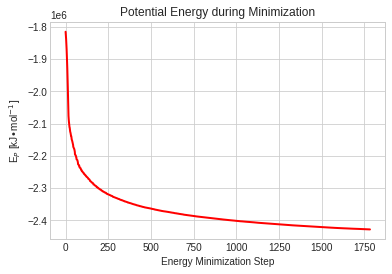

In [ ]:
#Plotting the potential energy of the system
import matplotlib.pyplot as plt
plt.style.use('seaborn-whitegrid')
import numpy as np

#Reading the text file containing this information
data = np.loadtxt('em_potential.xvg')

plt.title('Potential Energy during Minimization')
plt.xlabel('Energy Minimization Step')
plt.ylabel(r'E$_P$ [kJ•mol$^{-1}]$')
plt.plot(data[:,0], data[:,1], linestyle='solid', linewidth='2', color='red') 
plt.show()

Next, we will start our **equilibration**.

Thus, we will **equilibrate the energy and density of our system at constant temperature and pressure** before the MD production runs.

4. The first equilibration step is the **temperature**. Thus, we will start a MD simulation to equilibrate the system at a target temprature (in our case, 300K) using a thermal bath. The initial velocities for the atoms of our system at our target temperatureare obtained through a Maxwell distribution.

We will use an appropriate MD instruction file nvt.mdp and then run our simulation as we did before for the minimization. 

In [ ]:
%%bash
wget https://raw.githubusercontent.com/pb3lab/ibm3202/master/files/nvt.mdp

#Using grompp to prepare our NVT equilibration MD
source /content/gromacs/bin/GMXRC
gmx grompp -f nvt.mdp -c em.gro -r em.gro -p topol.top -o nvt.tpr

turning H bonds into constraints...
turning H bonds into constraints...
turning H bonds into constraints...
Analysing residue names:
There are:   315    Protein residues
There are: 44322      Water residues
There are:     2        Ion residues
Analysing Protein...
Analysing residues not classified as Protein/DNA/RNA/Water and splitting into groups...
Determining Verlet buffer for a tolerance of 0.005 kJ/mol/ps at 300 K
Calculated rlist for 1x1 atom pair-list as 1.296 nm, buffer size 0.096 nm
Set rlist, assuming 4x4 atom pair-list, to 1.224 nm, buffer size 0.024 nm
Note that mdrun will redetermine rlist based on the actual pair-list setup
Calculating fourier grid dimensions for X Y Z
Using a fourier grid of 72x72x72, spacing 0.157 0.157 0.157
This run will generate roughly 77 Mb of data


--2022-10-06 19:13:29--  https://raw.githubusercontent.com/pb3lab/ibm3202/master/files/nvt.mdp
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 2464 (2.4K) [text/plain]
Saving to: ‘nvt.mdp’

     0K ..                                                    100% 26.2M=0s

2022-10-06 19:13:29 (26.2 MB/s) - ‘nvt.mdp’ saved [2464/2464]

                      :-) GROMACS - gmx grompp, 2020.6 (-:

                            GROMACS is written by:
     Emile Apol      Rossen Apostolov      Paul Bauer     Herman J.C. Berendsen
    Par Bjelkmar      Christian Blau   Viacheslav Bolnykh     Kevin Boyd    
 Aldert van Buuren   Rudi van Drunen     Anton Feenstra       Alan Gray     
  Gerrit Groenhof     Anca Hamuraru    Vincent Hindriksen  M. Eric Irrgang  
  Aleksei Iupino

In [ ]:
%%time
%%bash
#Run our NVT equilibration MD
source /content/gromacs/bin/GMXRC
gmx mdrun -deffnm nvt -nb gpu

                      :-) GROMACS - gmx mdrun, 2020.6 (-:

                            GROMACS is written by:
     Emile Apol      Rossen Apostolov      Paul Bauer     Herman J.C. Berendsen
    Par Bjelkmar      Christian Blau   Viacheslav Bolnykh     Kevin Boyd    
 Aldert van Buuren   Rudi van Drunen     Anton Feenstra       Alan Gray     
  Gerrit Groenhof     Anca Hamuraru    Vincent Hindriksen  M. Eric Irrgang  
  Aleksei Iupinov   Christoph Junghans     Joe Jordan     Dimitrios Karkoulis
    Peter Kasson        Jiri Kraus      Carsten Kutzner      Per Larsson    
  Justin A. Lemkul    Viveca Lindahl    Magnus Lundborg     Erik Marklund   
    Pascal Merz     Pieter Meulenhoff    Teemu Murtola       Szilard Pall   
    Sander Pronk      Roland Schulz      Michael Shirts    Alexey Shvetsov  
   Alfons Sijbers     Peter Tieleman      Jon Vincent      Teemu Virolainen 
 Christian Wennberg    Maarten Wolf      Artem Zhmurov   
                           and the project leaders:
      

CPU times: user 979 ms, sys: 121 ms, total: 1.1 s
Wall time: 4min 9s


##nvt.edr 

5. What we just did corresponds to a simulation setup in which the number of atoms, the volume and the temperature are kept constant: **NVT ensemble**. Thus, the temperature of the system should oscillate around the desired temperature (in our case, 300 K). Let's check if this is true!

In [ ]:
%%bash
source /content/gromacs/bin/GMXRC

#This is a trick to provide interactive options to gmx
echo "Temperature" > options
echo " " >> options

#Using energy to extract the temperature of the system during the NVT equil MD
gmx energy -f nvt.edr -o nvt_temp.xvg -xvg none < options


Statistics over 50001 steps [ 0.0000 through 100.0000 ps ], 1 data sets
All statistics are over 501 points

Energy                      Average   Err.Est.       RMSD  Tot-Drift
-------------------------------------------------------------------------------
Temperature                 299.797        0.2    3.49599    1.12364  (K)


                      :-) GROMACS - gmx energy, 2020.6 (-:

                            GROMACS is written by:
     Emile Apol      Rossen Apostolov      Paul Bauer     Herman J.C. Berendsen
    Par Bjelkmar      Christian Blau   Viacheslav Bolnykh     Kevin Boyd    
 Aldert van Buuren   Rudi van Drunen     Anton Feenstra       Alan Gray     
  Gerrit Groenhof     Anca Hamuraru    Vincent Hindriksen  M. Eric Irrgang  
  Aleksei Iupinov   Christoph Junghans     Joe Jordan     Dimitrios Karkoulis
    Peter Kasson        Jiri Kraus      Carsten Kutzner      Per Larsson    
  Justin A. Lemkul    Viveca Lindahl    Magnus Lundborg     Erik Marklund   
    Pascal Merz     Pieter Meulenhoff    Teemu Murtola       Szilard Pall   
    Sander Pronk      Roland Schulz      Michael Shirts    Alexey Shvetsov  
   Alfons Sijbers     Peter Tieleman      Jon Vincent      Teemu Virolainen 
 Christian Wennberg    Maarten Wolf      Artem Zhmurov   
                           and the project leaders:
     

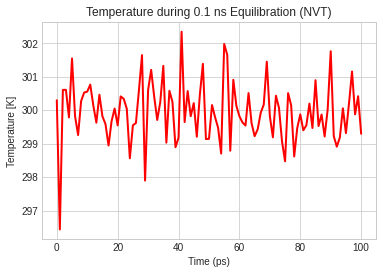

In [ ]:
#Plotting the temperature of the system
import matplotlib.pyplot as plt
plt.style.use('seaborn-whitegrid')
import numpy as np

#Reading the text file containing this information
data = np.loadtxt('nvt_temp.xvg')

plt.title('Temperature during 0.1 ns Equilibration (NVT)')
plt.xlabel('Time (ps)')
plt.ylabel('Temperature [K]')
plt.plot(data[:,0], data[:,1], linestyle='solid', linewidth='2', color='red') 
plt.show()

6. The final equilibration step will allow us to implement **pressure regulation** to our system, which will maintain the density and pressure of our solvent constant so that it matches what we would expect for the SPC/E water model.

  We will perform the same steps we did before: download an MD instruction file, and then use `grompp` and `mdrun` to run the MD simulation. One big difference between this simulation phase and the previous ones is that we will employ a **checkpoint state file** (nvt.cpt), which allows for a numerical continuation of our simulations. This file constitutes a checkpoint of the previous NVT simulation, containing the potential energy of the system and the velocities.

In [ ]:
%%bash
wget https://raw.githubusercontent.com/pb3lab/ibm3202/master/files/npt.mdp

#Using grompp to prepare our NPT equilibration MD
source /content/gromacs/bin/GMXRC
gmx grompp -f npt.mdp -c nvt.gro -r nvt.gro -t nvt.cpt -p topol.top -o npt.tpr

turning H bonds into constraints...
turning H bonds into constraints...
turning H bonds into constraints...
Analysing residue names:
There are:   315    Protein residues
There are: 44322      Water residues
There are:     2        Ion residues
Analysing Protein...
Analysing residues not classified as Protein/DNA/RNA/Water and splitting into groups...
Determining Verlet buffer for a tolerance of 0.005 kJ/mol/ps at 300 K
Calculated rlist for 1x1 atom pair-list as 1.296 nm, buffer size 0.096 nm
Set rlist, assuming 4x4 atom pair-list, to 1.224 nm, buffer size 0.024 nm
Note that mdrun will redetermine rlist based on the actual pair-list setup
Calculating fourier grid dimensions for X Y Z
Using a fourier grid of 72x72x72, spacing 0.157 0.157 0.157
This run will generate roughly 77 Mb of data


--2022-10-06 19:18:44--  https://raw.githubusercontent.com/pb3lab/ibm3202/master/files/npt.mdp
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 2687 (2.6K) [text/plain]
Saving to: ‘npt.mdp’

     0K ..                                                    100% 36.8M=0s

2022-10-06 19:18:45 (36.8 MB/s) - ‘npt.mdp’ saved [2687/2687]

                      :-) GROMACS - gmx grompp, 2020.6 (-:

                            GROMACS is written by:
     Emile Apol      Rossen Apostolov      Paul Bauer     Herman J.C. Berendsen
    Par Bjelkmar      Christian Blau   Viacheslav Bolnykh     Kevin Boyd    
 Aldert van Buuren   Rudi van Drunen     Anton Feenstra       Alan Gray     
  Gerrit Groenhof     Anca Hamuraru    Vincent Hindriksen  M. Eric Irrgang  
  Aleksei Iupino

In [ ]:
%%time
%%bash
#Run our NPT equilibration MD
source /content/gromacs/bin/GMXRC
gmx mdrun -deffnm npt -nb gpu

                      :-) GROMACS - gmx mdrun, 2020.6 (-:

                            GROMACS is written by:
     Emile Apol      Rossen Apostolov      Paul Bauer     Herman J.C. Berendsen
    Par Bjelkmar      Christian Blau   Viacheslav Bolnykh     Kevin Boyd    
 Aldert van Buuren   Rudi van Drunen     Anton Feenstra       Alan Gray     
  Gerrit Groenhof     Anca Hamuraru    Vincent Hindriksen  M. Eric Irrgang  
  Aleksei Iupinov   Christoph Junghans     Joe Jordan     Dimitrios Karkoulis
    Peter Kasson        Jiri Kraus      Carsten Kutzner      Per Larsson    
  Justin A. Lemkul    Viveca Lindahl    Magnus Lundborg     Erik Marklund   
    Pascal Merz     Pieter Meulenhoff    Teemu Murtola       Szilard Pall   
    Sander Pronk      Roland Schulz      Michael Shirts    Alexey Shvetsov  
   Alfons Sijbers     Peter Tieleman      Jon Vincent      Teemu Virolainen 
 Christian Wennberg    Maarten Wolf      Artem Zhmurov   
                           and the project leaders:
      

CPU times: user 979 ms, sys: 125 ms, total: 1.1 s
Wall time: 4min 16s


**⚠️CAUTION:** We used a Parrinello-Rahman barostat instead of Berendsen for the NPT equilibration. This should not be an issue if the system is adequately equilibrated, otherwise the combination of restraints and Parrinello-Rahman would be inappropriate as it could lead to instabilities.

7. Given that we are using an NPT ensemble to maintain our simulation at constant pressure and density, we should check if this is achieved.

In [ ]:
%%bash
source /content/gromacs/bin/GMXRC

#This is a trick to provide interactive options to gmx
echo "Pressure" > options
echo "Density" >> options
echo " "

#Using energy to extract the pressure and density of the system during the NPT equil MD
gmx energy -f npt.edr -o npt_press_dens.xvg -xvg none < options

 

Statistics over 50001 steps [ 0.0000 through 100.0000 ps ], 2 data sets
All statistics are over 501 points

Energy                      Average   Err.Est.       RMSD  Tot-Drift
-------------------------------------------------------------------------------
Pressure                   0.493284        1.6    91.4742    3.10945  (bar)
Density                     1009.56       0.45    3.58123    1.81072  (kg/m^3)


                      :-) GROMACS - gmx energy, 2020.6 (-:

                            GROMACS is written by:
     Emile Apol      Rossen Apostolov      Paul Bauer     Herman J.C. Berendsen
    Par Bjelkmar      Christian Blau   Viacheslav Bolnykh     Kevin Boyd    
 Aldert van Buuren   Rudi van Drunen     Anton Feenstra       Alan Gray     
  Gerrit Groenhof     Anca Hamuraru    Vincent Hindriksen  M. Eric Irrgang  
  Aleksei Iupinov   Christoph Junghans     Joe Jordan     Dimitrios Karkoulis
    Peter Kasson        Jiri Kraus      Carsten Kutzner      Per Larsson    
  Justin A. Lemkul    Viveca Lindahl    Magnus Lundborg     Erik Marklund   
    Pascal Merz     Pieter Meulenhoff    Teemu Murtola       Szilard Pall   
    Sander Pronk      Roland Schulz      Michael Shirts    Alexey Shvetsov  
   Alfons Sijbers     Peter Tieleman      Jon Vincent      Teemu Virolainen 
 Christian Wennberg    Maarten Wolf      Artem Zhmurov   
                           and the project leaders:
     

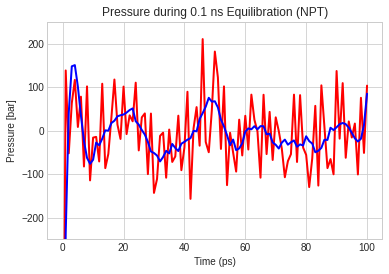

In [ ]:
#Plotting the density of the system
import matplotlib.pyplot as plt
plt.style.use('seaborn-whitegrid')
import numpy as np

#Reading the text file containing this information
data = np.loadtxt('npt_press_dens.xvg')

plt.title('Pressure during 0.1 ns Equilibration (NPT)')
plt.xlabel('Time (ps)')
plt.ylabel('Pressure [bar]')
plt.ylim(-250,250)

#Smoothing using Savitzky-Golay
from scipy.signal import savgol_filter
yhat = savgol_filter(data[:,1], 21, 5)

#Plot raw data and spline interpolation
plt.plot(data[:,0], data[:,1], linestyle='solid', linewidth='2', color='red')
plt.plot(data[:,0], yhat, linestyle='solid', linewidth='2', color='blue') 
plt.show()

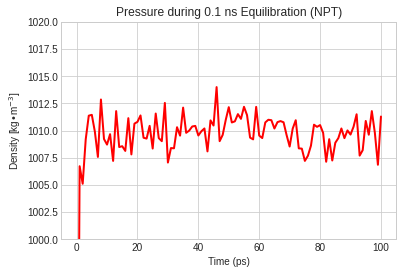

In [ ]:
#Plotting the pressure of the system
import matplotlib.pyplot as plt
plt.style.use('seaborn-whitegrid')
import numpy as np

#Reading the text file containing this information
data = np.loadtxt('npt_press_dens.xvg')

plt.title('Pressure during 0.1 ns Equilibration (NPT)')
plt.xlabel('Time (ps)')
plt.ylabel('Density [kg•m$^{-3}$]')
plt.ylim(1000,1020)
plt.plot(data[:,0], data[:,2], linestyle='solid', linewidth='2', color='red') 
plt.show()

#Part III – Obtain a production MD run and analyze the results

Now we are ready for running our MD simulations. If we are using a typical NPT ensemble, we can just continue our simulation similar to our second equilibration, but without having any position restraints (without the `-r` option).

1. If you have paid attention to our previous MD runs, you will fully understand what is annotated in the following code cells. Due to time constraints and the size of the system, we are only generating **0.1 ns of production runs**, whilst you will find that simulations in current articles often correspond to hundreds of ns.

In [ ]:
%%bash
wget https://raw.githubusercontent.com/pb3lab/ibm3202/master/files/md.mdp

#Using grompp to prepare our production MD
source /content/gromacs/bin/GMXRC
gmx grompp -f md.mdp -c npt.gro -t npt.cpt -p topol.top -o md_1.tpr

turning H bonds into constraints...
turning H bonds into constraints...
turning H bonds into constraints...
Analysing residue names:
There are:   315    Protein residues
There are: 44322      Water residues
There are:     2        Ion residues
Analysing Protein...
Analysing residues not classified as Protein/DNA/RNA/Water and splitting into groups...
Determining Verlet buffer for a tolerance of 0.005 kJ/mol/ps at 300 K
Calculated rlist for 1x1 atom pair-list as 1.297 nm, buffer size 0.097 nm
Set rlist, assuming 4x4 atom pair-list, to 1.225 nm, buffer size 0.025 nm
Note that mdrun will redetermine rlist based on the actual pair-list setup
Calculating fourier grid dimensions for X Y Z
Using a fourier grid of 72x72x72, spacing 0.154 0.154 0.154
This run will generate roughly 44 Mb of data


--2022-10-06 19:29:54--  https://raw.githubusercontent.com/pb3lab/ibm3202/master/files/md.mdp
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 2619 (2.6K) [text/plain]
Saving to: ‘md.mdp’

     0K ..                                                    100% 30.9M=0s

2022-10-06 19:29:55 (30.9 MB/s) - ‘md.mdp’ saved [2619/2619]

                      :-) GROMACS - gmx grompp, 2020.6 (-:

                            GROMACS is written by:
     Emile Apol      Rossen Apostolov      Paul Bauer     Herman J.C. Berendsen
    Par Bjelkmar      Christian Blau   Viacheslav Bolnykh     Kevin Boyd    
 Aldert van Buuren   Rudi van Drunen     Anton Feenstra       Alan Gray     
  Gerrit Groenhof     Anca Hamuraru    Vincent Hindriksen  M. Eric Irrgang  
  Aleksei Iupinov  

In [ ]:
#Check the content of the production MD file
!paste md.mdp

; Run parameters
integrator              = md        ; leap-frog integrator
nsteps                  = 50000    ; 2 * 50000 = 100 ps (0.1 ns)
dt                      = 0.002     ; 2 fs

; Output control
nstxout                 = 0         ; suppress bulky .trr file by specifying 
nstvout                 = 0         ; 0 for output frequency of nstxout,
nstfout                 = 0         ; nstvout, and nstfout
nstenergy               = 1000      ; save energies every 2.0 ps
nstlog                  = 1000      ; update log file every 2.0 ps
nstxout-compressed      = 1000      ; save compressed coordinates every 2.0 ps
compressed-x-grps       = System    ; save the whole system

; Bond parameters
continuation            = yes       ; Restarting after NPT 
constraint_algorithm    = lincs     ; holonomic constraints 
constraints             = h-bonds   ; bonds involving H are constrained
lincs_iter              = 1         ; accuracy of LINCS
lincs_order             = 4         ; also relate

In [ ]:
%%time
%%bash
#Run our production MD
source /content/gromacs/bin/GMXRC
gmx mdrun -deffnm md_1 -nb gpu

                      :-) GROMACS - gmx mdrun, 2020.6 (-:

                            GROMACS is written by:
     Emile Apol      Rossen Apostolov      Paul Bauer     Herman J.C. Berendsen
    Par Bjelkmar      Christian Blau   Viacheslav Bolnykh     Kevin Boyd    
 Aldert van Buuren   Rudi van Drunen     Anton Feenstra       Alan Gray     
  Gerrit Groenhof     Anca Hamuraru    Vincent Hindriksen  M. Eric Irrgang  
  Aleksei Iupinov   Christoph Junghans     Joe Jordan     Dimitrios Karkoulis
    Peter Kasson        Jiri Kraus      Carsten Kutzner      Per Larsson    
  Justin A. Lemkul    Viveca Lindahl    Magnus Lundborg     Erik Marklund   
    Pascal Merz     Pieter Meulenhoff    Teemu Murtola       Szilard Pall   
    Sander Pronk      Roland Schulz      Michael Shirts    Alexey Shvetsov  
   Alfons Sijbers     Peter Tieleman      Jon Vincent      Teemu Virolainen 
 Christian Wennberg    Maarten Wolf      Artem Zhmurov   
                           and the project leaders:
      

CPU times: user 1.04 s, sys: 125 ms, total: 1.17 s
Wall time: 4min 20s


2. To finalize, we will visualize our simulation. For this, we will use the `trjconv` module to extract only the protein from our system and convert our trajectory into a PDB file.

We will also take the opportunity to recenter the periodic box on our protein such that its atoms do not stretch through the edges of the periodic boundary conditions using the `-pbc mol` and `-center` options.

In [ ]:
%%bash
source /content/gromacs/bin/GMXRC

#This is a trick to provide interactive options to gmx
echo "Protein" > options
echo "Protein" >> options
echo " "

#Using trjconv to extract only the protein atoms from the simulation trajectory
#and also recenter the protein if its atoms crossed the periodic boundaries
gmx trjconv -s md_1.tpr -f md_1.xtc -o md_1_protPBC.pdb -pbc mol -center < options

 
Note that major changes are planned in future for trjconv, to improve usability and utility.
Select group for centering
Selected 1: 'Protein'
Select group for output
Selected 1: 'Protein'


                     :-) GROMACS - gmx trjconv, 2020.6 (-:

                            GROMACS is written by:
     Emile Apol      Rossen Apostolov      Paul Bauer     Herman J.C. Berendsen
    Par Bjelkmar      Christian Blau   Viacheslav Bolnykh     Kevin Boyd    
 Aldert van Buuren   Rudi van Drunen     Anton Feenstra       Alan Gray     
  Gerrit Groenhof     Anca Hamuraru    Vincent Hindriksen  M. Eric Irrgang  
  Aleksei Iupinov   Christoph Junghans     Joe Jordan     Dimitrios Karkoulis
    Peter Kasson        Jiri Kraus      Carsten Kutzner      Per Larsson    
  Justin A. Lemkul    Viveca Lindahl    Magnus Lundborg     Erik Marklund   
    Pascal Merz     Pieter Meulenhoff    Teemu Murtola       Szilard Pall   
    Sander Pronk      Roland Schulz      Michael Shirts    Alexey Shvetsov  
   Alfons Sijbers     Peter Tieleman      Jon Vincent      Teemu Virolainen 
 Christian Wennberg    Maarten Wolf      Artem Zhmurov   
                           and the project leaders:
     

3. Now, you can download this new PDB file and load it onto [**NGLviewer**](http://nglviewer.org/ngl/) as a **trajectory** PDB file to visualize the protein motions explored within this short simulation time.